<a href="https://colab.research.google.com/github/waikikidongdong/mypage/blob/main/artillery.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip uninstall -y tensorflow keras

Found existing installation: tensorflow 2.11.0
Uninstalling tensorflow-2.11.0:
  Successfully uninstalled tensorflow-2.11.0
Found existing installation: keras 2.11.0
Uninstalling keras-2.11.0:
  Successfully uninstalled keras-2.11.0


In [ ]:
!git clone https://github.com/zzh8829/yolov3-tf2
%cd yolov3-tf2/
!pip install -r requirements-gpu.txt
!pip install keras==2.4.2
!pip install tensorflow

Cloning into 'yolov3-tf2'...
remote: Enumerating objects: 442, done.
remote: Counting objects: 100% (9/9), done.
remote: Compressing objects: 100% (9/9), done.
remote: Total 442 (delta 3), reused 2 (delta 0), pack-reused 433
Receiving objects: 100% (442/442), 4.24 MiB | 18.89 MiB/s, done.
Resolving deltas: 100% (251/251), done.
/content/yolov3-tf2
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Obtaining file:///content/yolov3-tf2 (from -r requirements-gpu.txt (line 6))
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 454.5/454.5 MB 3.0 MB/s eta 0:00:00
ERROR: Could not find a version that satisfies the requirement opencv-python==4.2.0.32 (from versions: 3.4.0.14, 3.4.10.37, 3.4.11.39, 3.4.11.41, 3.4.11.43, 3.4.11.45, 3.4.13.47, 3.4.14.51, 3.4.14.53, 3.4.15.55, 3.4.16.57, 3.4.16.59, 3.4.17.61, 3.4.17.63, 3.4.18.65, 4.3.0.38, 4.4.0.40, 4.4.0.42, 4.4.0.44, 4.4.0.46, 4.5.1.48, 4.5.2.52, 4.5.2.54, 4.5.3

In [ ]:
!wget https://pjreddie.com/media/files/yolov3.weights -O data/yolov3.weights
!python convert.py --weights ./data/yolov3.weights --output ./checkpoints/yolov3.tf

--2023-03-26 11:41:05--  https://pjreddie.com/media/files/yolov3.weights
Resolving pjreddie.com (pjreddie.com)... 128.208.4.108
Connecting to pjreddie.com (pjreddie.com)|128.208.4.108|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 248007048 (237M) [application/octet-stream]
Saving to: ‘data/yolov3.weights’

data/yolov3.weights 100%[===================>] 236.52M  17.0MB/s    in 15s     

2023-03-26 11:41:21 (16.0 MB/s) - ‘data/yolov3.weights’ saved [248007048/248007048]

2023-03-26 11:41:22.864060: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Model: "yolov3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input (InputLayer)             [(None, None, None,  0           []                               
                                 3)]                         

In [ ]:
import time
import cv2
import numpy as np
import tensorflow as tf
from yolov3_tf2.models import YoloV3
from yolov3_tf2.dataset import transform_images, load_tfrecord_dataset
from yolov3_tf2.utils import draw_outputs
from absl import app, logging, flags
from absl.flags import FLAGS

from tensorflow.keras.preprocessing import image
import matplotlib.pyplot as plt
from IPython.display import Image, display

In [ ]:
flags.DEFINE_string('classes', './data/coco.names', 'classes file')
flags.DEFINE_string('weights', './checkpoints/yolov3.tf', 'weights file')
flags.DEFINE_boolean('tiny', False, 'yolov3 or yolov3-tiny')
flags.DEFINE_integer('size', 416, 'resize images to')
flags.DEFINE_string('image', './data/girl.png', 'input image')
flags.DEFINE_string('tfrecord', None, 'tfrecord')
flags.DEFINE_string('output', './output.jpg', 'output image')
flags.DEFINE_integer('num_classes', 80, 'number of classes')


app._run_init(['yolov3'], app.parse_flags_with_usage)
physical_devices = tf.config.experimental.list_physical_devices('GPU')
tf.config.experimental.set_memory_growth(physical_devices[0], True)
# if physical_devices:
   # try:
    #    tf.config.experimental.set_memory_growth(physical_devices[0], True)
    #except:
        # Invalid device or cannot modify virtual devices once initialized.
     #   pass

In [ ]:
config = tf.compat.v1.ConfigProto()
config.gpu_options.allow_growth = True
sess = tf.compat.v1.Session(config=config)

In [ ]:
yolo = YoloV3(classes=FLAGS.num_classes)
yolo.load_weights(FLAGS.weights).expect_partial()
class_names = [c.strip() for c in open(FLAGS.classes).readlines()]

In [ ]:
def detector():
  img_raw = tf.image.decode_image(open(FLAGS.image, 'rb').read(), channels=3)

  img = tf.expand_dims(img_raw, 0)
  img = transform_images(img, FLAGS.size)

  t1 = time.time()
  boxes, scores, classes, nums = yolo(img)
  t2 = time.time()
  print('time: {}'.format(t2-t1))

  for i in range(nums[0]):
    print('{}.{}.{}'.format(class_names[int(classes[0][i])],
                            np.array(scores[0][i]),
                            np.array(boxes[0][i])))
    
  img = cv2.cvtColor(img_raw.numpy(), cv2.COLOR_RGB2BGR)
  img = draw_outputs(img, (boxes, scores, classes, nums), class_names)

  return img



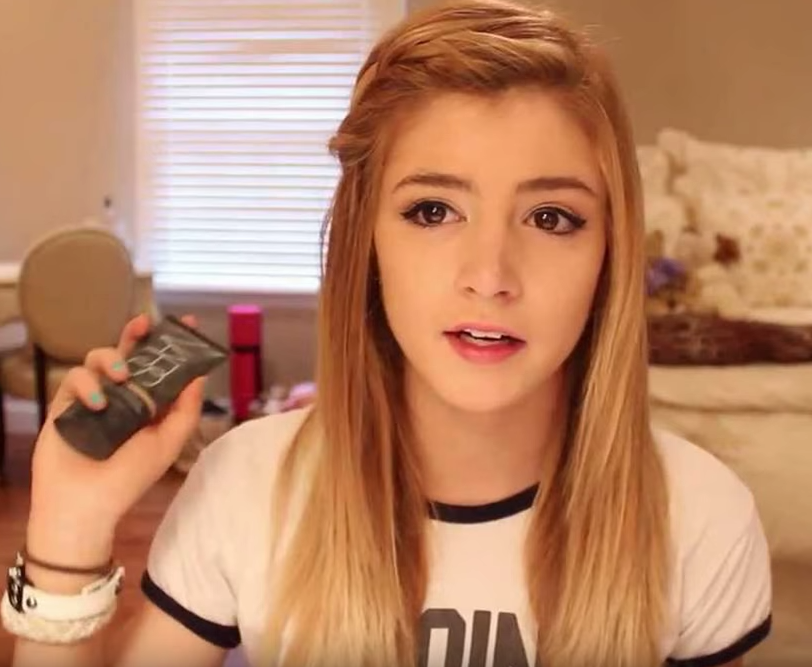

In [ ]:
FLAGS.image = 'data/girl.png'
Image(filename=FLAGS.image, width=500)

time: 2.2884345054626465
person.0.9997697472572327.[0.06754467 0.03718698 0.967988   0.9650754 ]
chair.0.9255480766296387.[0.0185187  0.34200275 0.17385134 0.62783295]


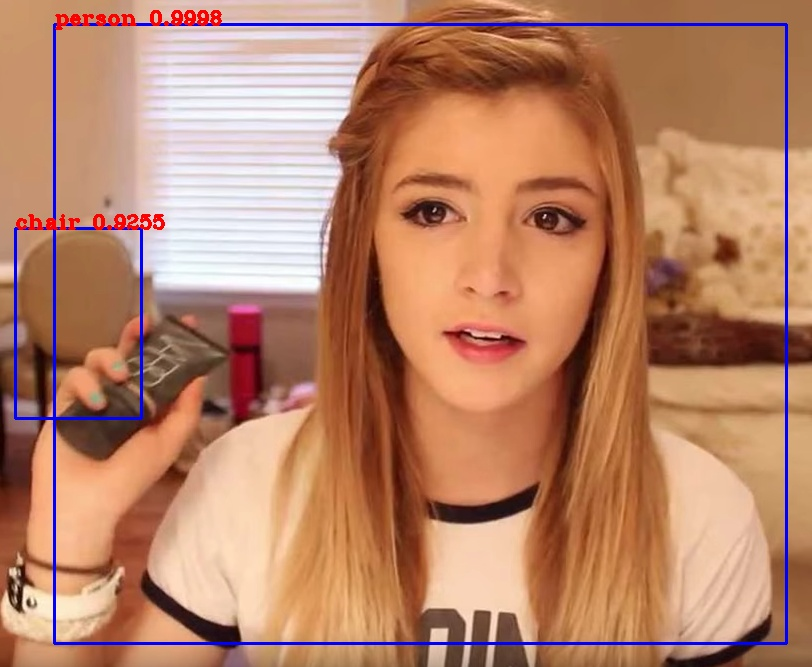

In [ ]:
output = detector()
display(Image(data=bytes(cv2.imencode('.jpg', output)[1]), width=500))

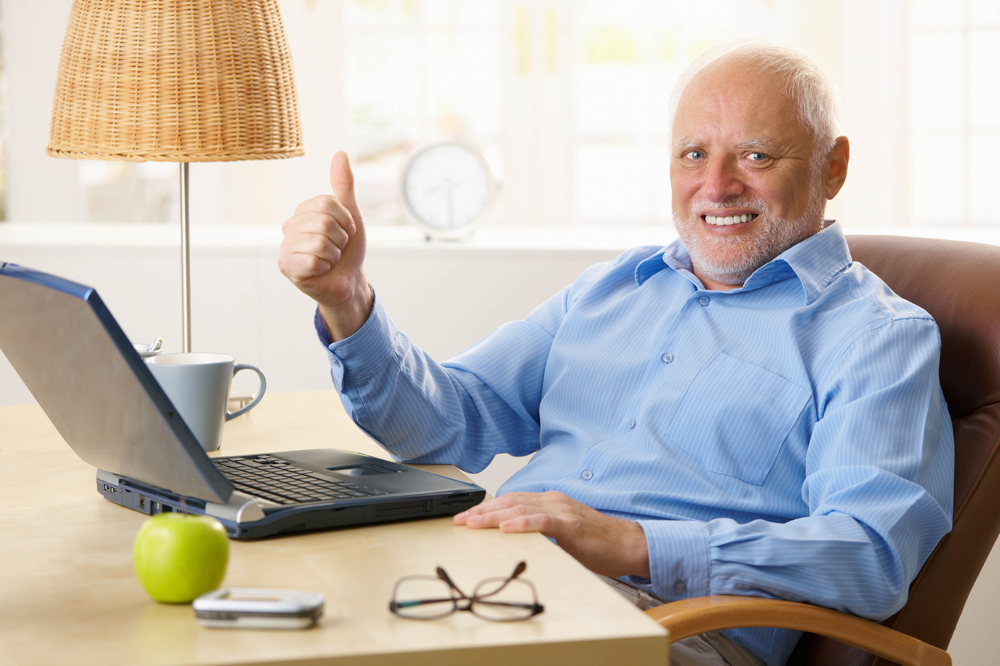

In [ ]:
FLAGS.image = 'data/meme.jpg'
Image(filename=FLAGS.image, width=1000)

time: 0.1328725814819336
cup.0.9980731010437012.[0.14266218 0.52777606 0.27184254 0.65748256]
person.0.9976975321769714.[0.2898291  0.09854648 0.95846486 0.9202168 ]
laptop.0.9599869847297668.[-0.01710647  0.39493692  0.52297276  0.7962775 ]
apple.0.9081628322601318.[0.13114463 0.77143586 0.22893356 0.90729535]
cell phone.0.732137143611908.[0.18850097 0.87569416 0.3350185  0.9422209 ]
clock.0.6700018048286438.[0.4010809  0.2124461  0.49267417 0.35021502]
cup.0.5366387367248535.[0.15088229 0.52855617 0.25541586 0.66439587]
chair.0.5001124739646912.[0.29507306 0.30677184 0.99988616 0.9955944 ]


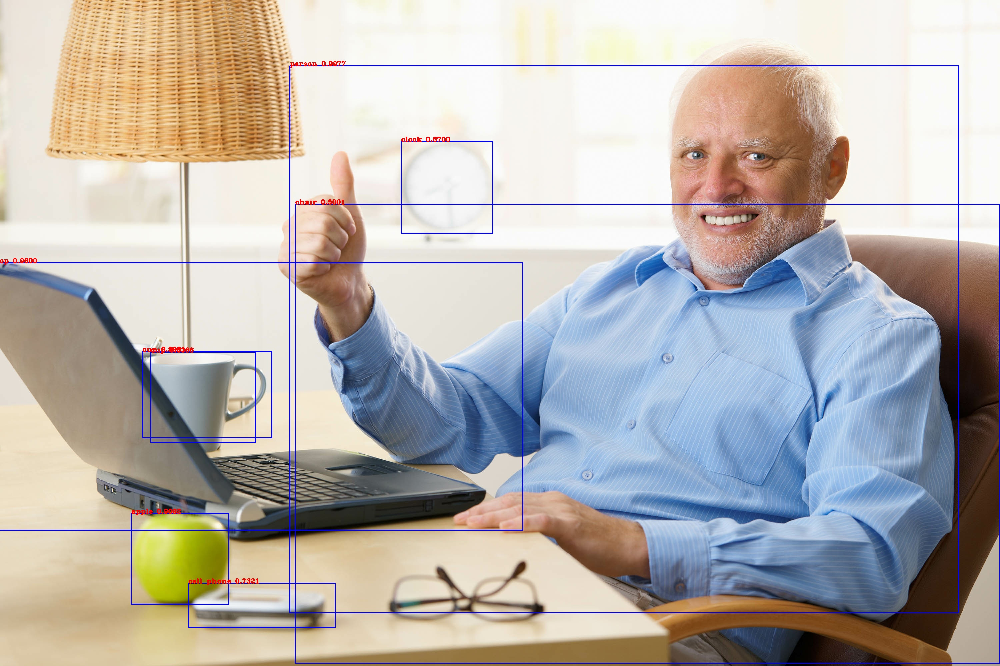

In [ ]:
output = detector()
display(Image(data=bytes(cv2.imencode('.jpg', output)[1]), width=1000))

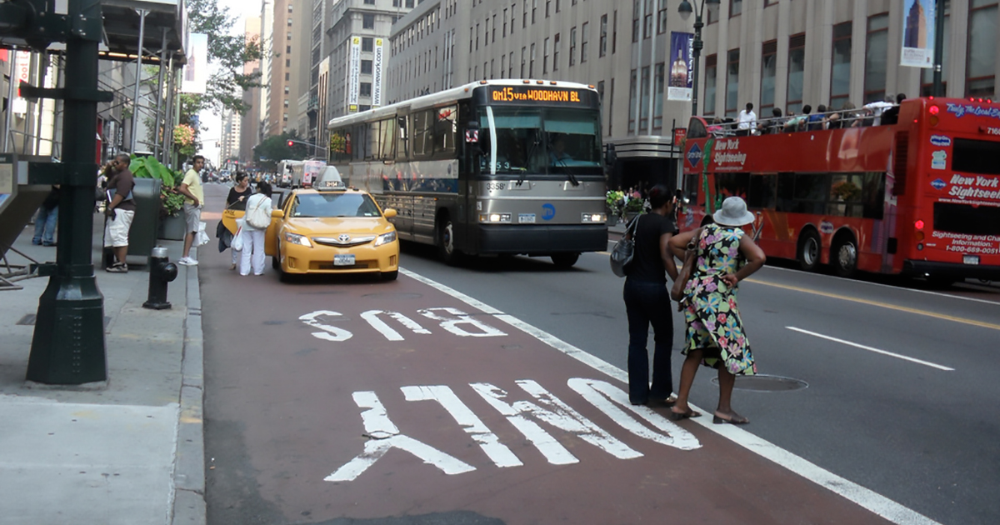

In [ ]:
FLAGS.image = 'data/street.jpg'
Image(filename=FLAGS.image, width=1000)

time: 2.3944942951202393
person.0.9997697472572327.[0.06754467 0.03718707 0.967988   0.96507525]
chair.0.9255481958389282.[0.01851872 0.34200275 0.17385136 0.62783295]


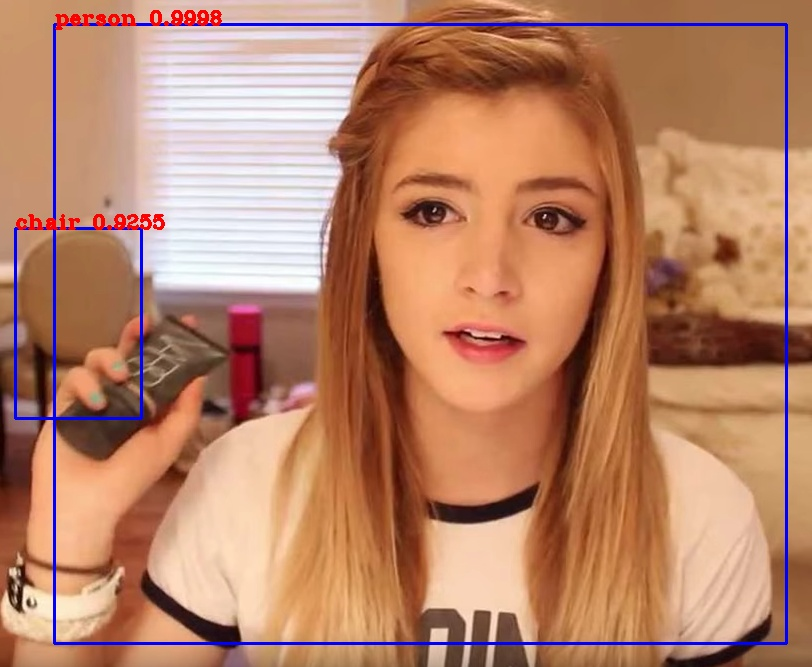

In [ ]:
output = detector()
display(Image(data=bytes(cv2.imencode('.jpg', output)[1]), width=1000))

In [ ]:
%cd /content
!git clone https://github.com/ultralytics/yolov5
%cd yolov5
%pip install -qr requirements.txt

import torch
from IPython.display import Image, clear_output

/content
Cloning into 'yolov5'...
remote: Enumerating objects: 15338, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 15338 (delta 0), reused 2 (delta 0), pack-reused 15335
Receiving objects: 100% (15338/15338), 14.15 MiB | 19.58 MiB/s, done.
Resolving deltas: 100% (10524/10524), done.
/content/yolov5
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 KB 12.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 KB 8.3 MB/s eta 0:00:00


In [ ]:
!ls data/images

bus.jpg  zidane.jpg


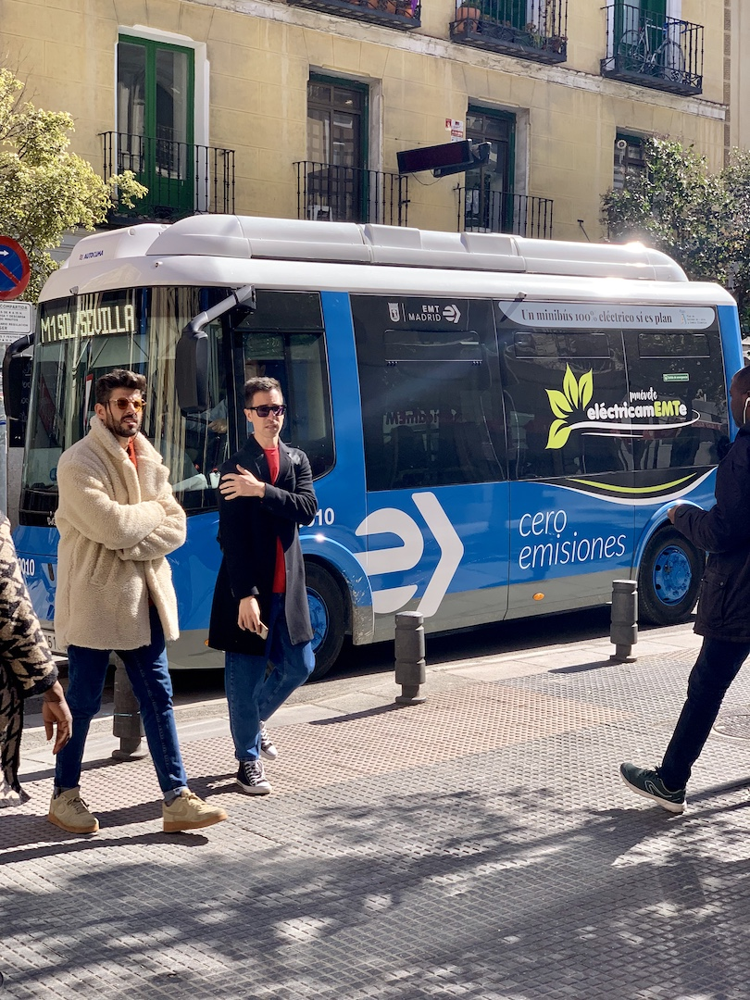

In [ ]:
Image(filename='data/images/bus.jpg', width=600)

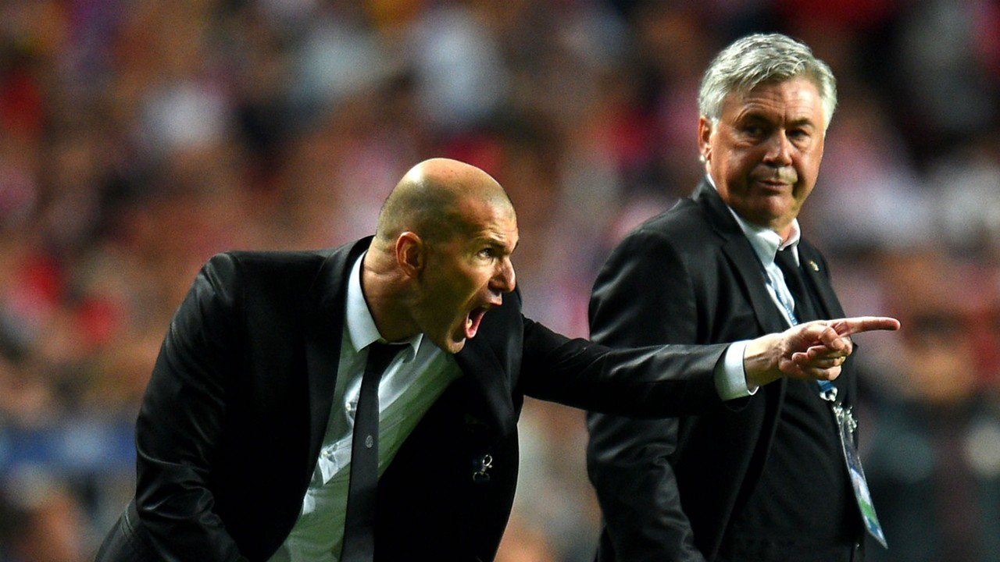

In [ ]:
Image(filename='data/images/zidane.jpg', width=600)

In [ ]:
!python detect.py --weights yolov5s.pt --img 640 --conf 0.25 --source data/images/

detect: weights=['yolov5s.pt'], source=data/images/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-128-gb96f35c Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

100% 14.1M/14.1M [00:00<00:00, 20.4MB/s]

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients
image 1/2 /content/yolov5/data/images/bus.jpg: 640x480 4 persons, 1 bus, 19.9ms
image 2/2 /content/yolov5/data/images/zidane.jpg: 384x640 2 persons, 2 ties, 16.0ms
Speed: 0.7ms pre-process, 18.0ms inference, 18.1ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp


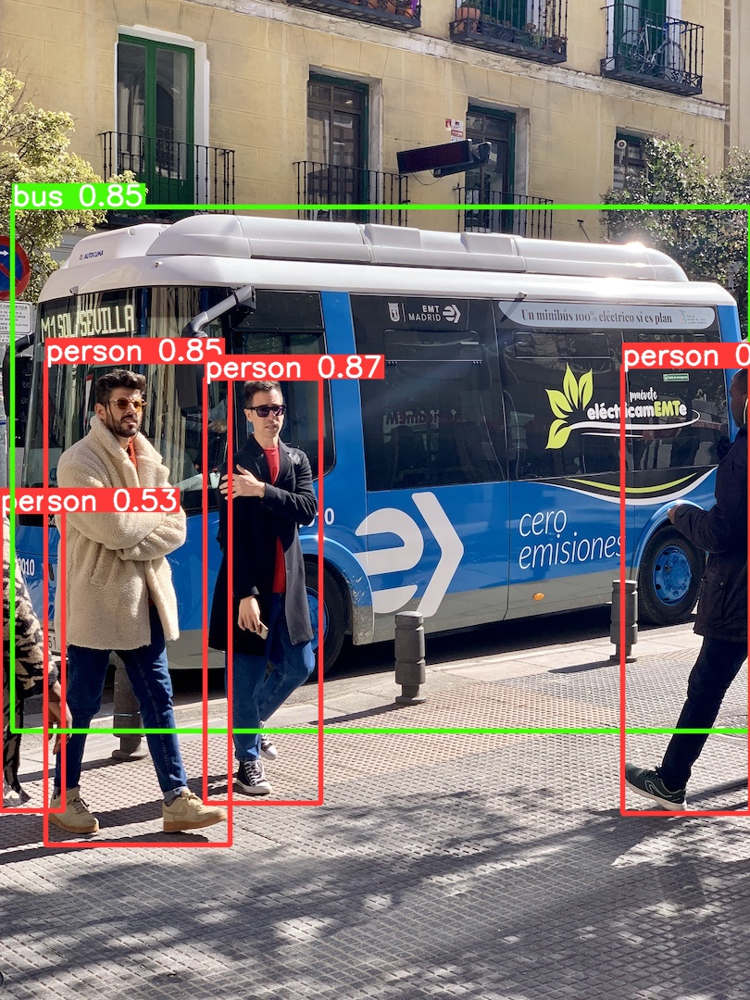

In [ ]:
Image(filename='runs/detect/exp/bus.jpg', width=600)

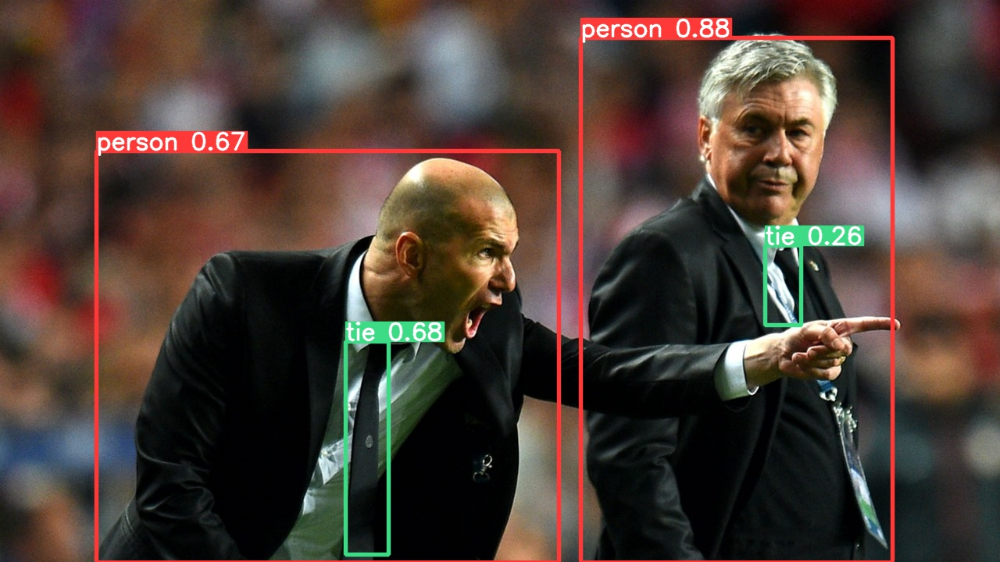

In [ ]:
Image(filename='runs/detect/exp/zidane.jpg', width=600)

In [ ]:
%mkdir /content/yolov5/smoke
%cd /content/yolov5/smoke
!curl -L "https://public.roboflow.com/ds/c3QzplEW7j?key=IojnVnrzOz" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

/content/yolov5/smoke
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   901  100   901    0     0   1736      0 --:--:-- --:--:-- --:--:--  1736
100 27.6M  100 27.6M    0     0  35.8M      0 --:--:-- --:--:-- --:--:--  151M
Archive:  roboflow.zip
 extracting: test/images/ck0rqdyeq4kxa08633xv2wqe1_jpeg.rf.30df6babe258cdc1d5a4e042262665e4.jpg  
 extracting: test/images/ck0qd918zic840701hnezgpgy_jpeg.rf.30de65aa3639b8a113db71a11bc2726c.jpg  
 extracting: test/images/ck0kfjen48qhj0701wjkosmel_jpeg.rf.49b365cc7135deee1332e6657401abc5.jpg  
 extracting: test/images/ck0t7cczuqxtt07212nj5eznh_jpeg.rf.1a9299c8658d89f6271dba2aeefe074d.jpg  
 extracting: test/images/ck0kn8y5y9y3507018k5p06ma_jpeg.rf.466b2fb63a73c0138cf75b3ddc71d490.jpg  
 extracting: test/images/ck0tzjni6sjt50863e6a6a8fl_jpeg.rf.46d343d22cd08c90668cc0d50bc52a2d.jpg  
 extracting: test/images/ck0tszlepw02k0721zr71djfj_

In [ ]:
from glob import glob

train_img_list = glob('/content/yolov5/smoke/train/images/*.jpg')
test_img_list = glob('/content/yolov5/smoke/test/images/*.jpg')
valid_img_list = glob('/content/yolov5/smoke/valid/images/*.jpg')
print(len(train_img_list), len(test_img_list), len(valid_img_list))

516 74 147


In [ ]:
from glob import glob

train_img_list = glob('/content/yolov5/artillery/train/images/*.png')
test_img_list = glob('/content/yolov5/artillery/test/images/*.png')
valid_img_list = glob('/content/yolov5/artillery/valid/images/*.png')
print(len(train_img_list), len(test_img_list), len(valid_img_list))

74 7 10


In [ ]:
import yaml

with open('/content/yolov5/smoke/train.txt', 'w') as f:
  f.write('\n'.join(train_img_list)+'\n')

with open('/content/yolov5/smoke/test.txt', 'w') as f:
  f.write('\n'.join(test_img_list)+'\n')

with open('/content/yolov5/smoke/val.txt', 'w') as f:
  f.write('\n'.join(valid_img_list)+'\n')

In [ ]:
import yaml

with open('/content/yolov5/artillery/train.txt', 'w') as f:
  f.write('\n'.join(train_img_list)+'\n')

with open('/content/yolov5/artillery/test.txt', 'w') as f:
  f.write('\n'.join(test_img_list)+'\n')

with open('/content/yolov5/artillery/val.txt', 'w') as f:
  f.write('\n'.join(valid_img_list)+'\n')

In [ ]:
%cat /content/yolov5/smoke/data.yaml

train: ../train/images
val: ../valid/images

nc: 1
names: ['smoke']

In [ ]:
%cat /content/yolov5/artillery/data.yaml

cat: /content/yolov5/artillery/data.yaml: No such file or directory


In [ ]:
from IPython.core.magic import register_line_cell_magic
@register_line_cell_magic
def writetemplate(line, cell):
  with open(line, 'w') as f:
    f.write(cell.format(**globals()))

In [ ]:
%%writetemplate /content/yolov5/smoke/data.yaml

train: ./smoke/train/images
test: ./smoke/test/images
val: ./smoke/valid/images

nc: 1
names: ['smoke']

In [ ]:
%%writetemplate /content/yolov5/artillery/data.yaml

train: ./artillery/train/images
test: ./artillery/test/images
val: ./artillery/valid/images

nc: 1
names: ['artillery']

In [ ]:
%cat /content/yolov5/smoke/data.yaml


train: ./smoke/train/images
test: ./smoke/test/images
val: ./smoke/valid/images

nc: 1
names: ['smoke']


In [ ]:
%cat /content/yolov5/artillery/data.yaml


train: ./artillery/train/images
test: ./artillery/test/images
val: ./artillery/valid/images

nc: 1
names: ['artillery']


In [ ]:
import yaml

with open("/content/yolov5/smoke/data.yaml", 'r') as stream:
  num_classes = str(yaml.safe_load(stream)['nc'])

%cat /content/yolov5/models/yolov5s.yaml

# YOLOv5 🚀 by Ultralytics, GPL-3.0 license

# Parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]]

In [ ]:
import yaml

with open("/content/yolov5/artillery/data.yaml", 'r') as stream:
  num_classes = str(yaml.safe_load(stream)['nc'])

%cat /content/yolov5/models/yolov5s.yaml

# YOLOv5 🚀 by Ultralytics, GPL-3.0 license

# Parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]]

In [ ]:
%%writetemplate /content/yolov5/models/custom_yolov5s.yaml

# Parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, C3, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, C3, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]


In [ ]:
%cat /content/yolov5/models/custom_yolov5s.yaml


# Parameters
nc: 1  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, C3, [256, Fa

In [ ]:
%%time
%cd /content/yolov5
!python train.py --img 640 --batch 16 --epochs 100 --data ./smoke/data.yaml --cfg ./models/custom_yolov5s.yaml --weights '' --name smoke_results --cache

/content/yolov5
train: weights=, cfg=./models/custom_yolov5s.yaml, data=./smoke/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=smoke_results, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-128-gb96f35c Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0,

In [ ]:
%%time
%cd /content/yolov5
!python train.py --img 640 --batch 32 --epochs 200 --data ./artillery/data.yaml --cfg ./models/custom_yolov5s.yaml --weights '' --name artillery_results --cache

/content/yolov5
train: weights=, cfg=./models/custom_yolov5s.yaml, data=./artillery/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=200, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=artillery_results, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-128-gb96f35c Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, ancho

In [ ]:
%%time
%cd /content/yolov5
!python train.py --img 640 --batch 32 --epochs 200 --data ./artillery/data.yaml --cfg ./models/custom_yolov5s.yaml --weights '' --name artillery_results --cache

/content/yolov5
train: weights=, cfg=./models/custom_yolov5s.yaml, data=./artillery/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=200, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=artillery_results, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-116-g5c91dae Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, ancho

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [ ]:
!Is runs/train/artillery_results2

/bin/bash: Is: command not found


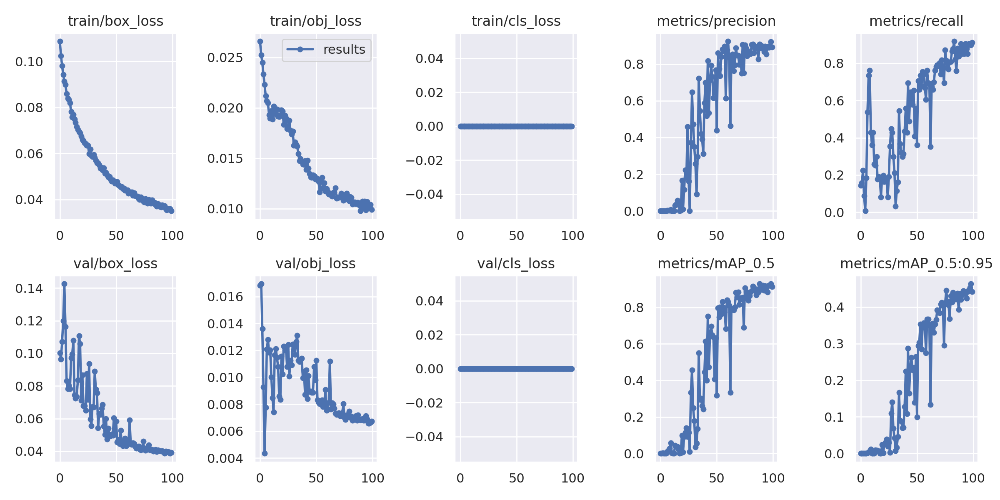

In [ ]:
Image(filename='runs/train/smoke_results4/results.png', width=1000)

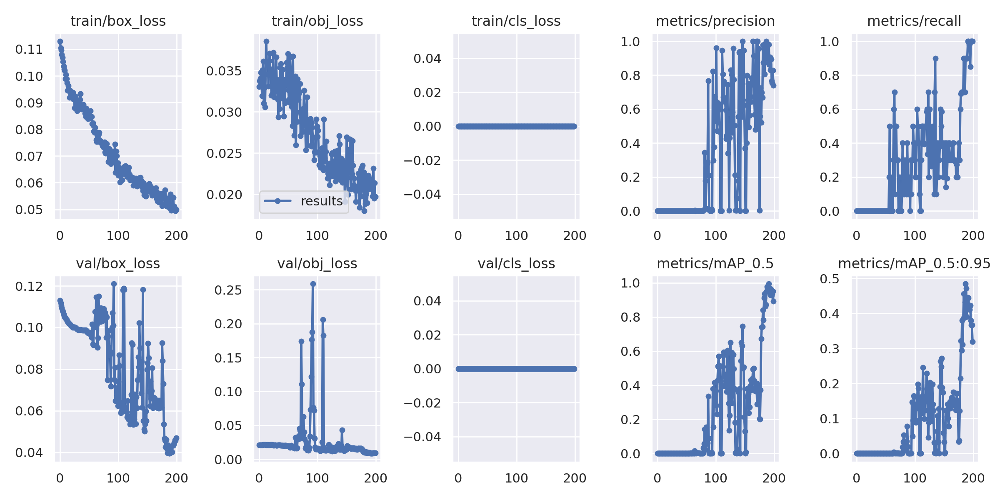

In [ ]:
Image(filename='runs/train/artillery_results2/results.png', width=1000)

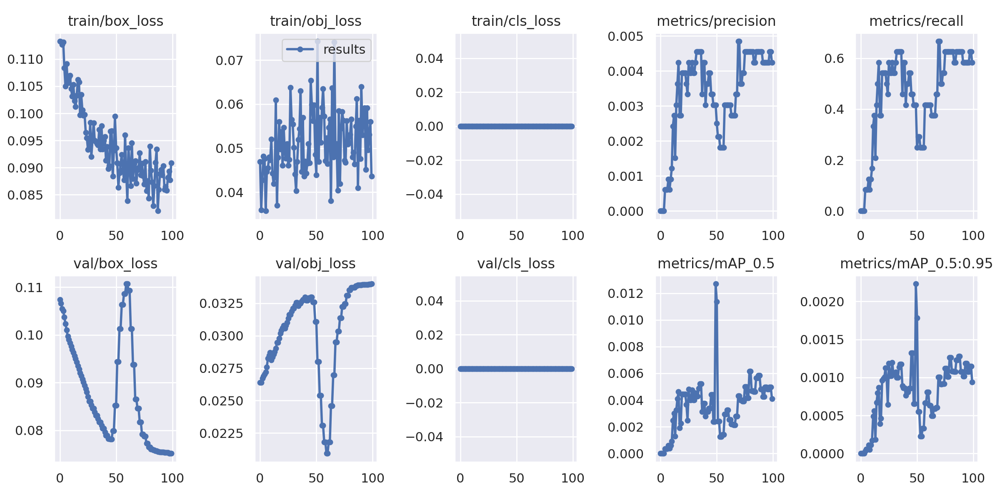

In [ ]:
Image(filename='runs/train/artillery_results3/results.png', width=1000)

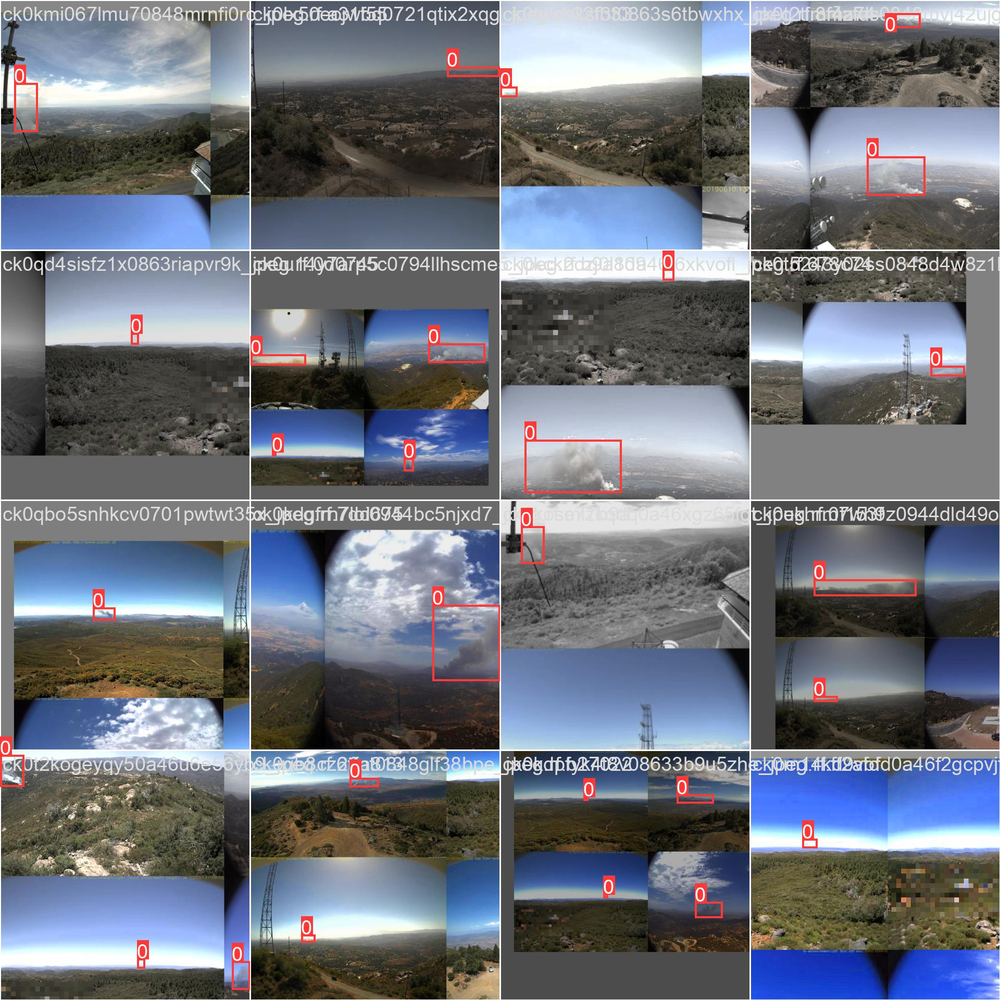

In [ ]:
Image(filename='runs/train/smoke_results4/train_batch0.jpg', width=1000)

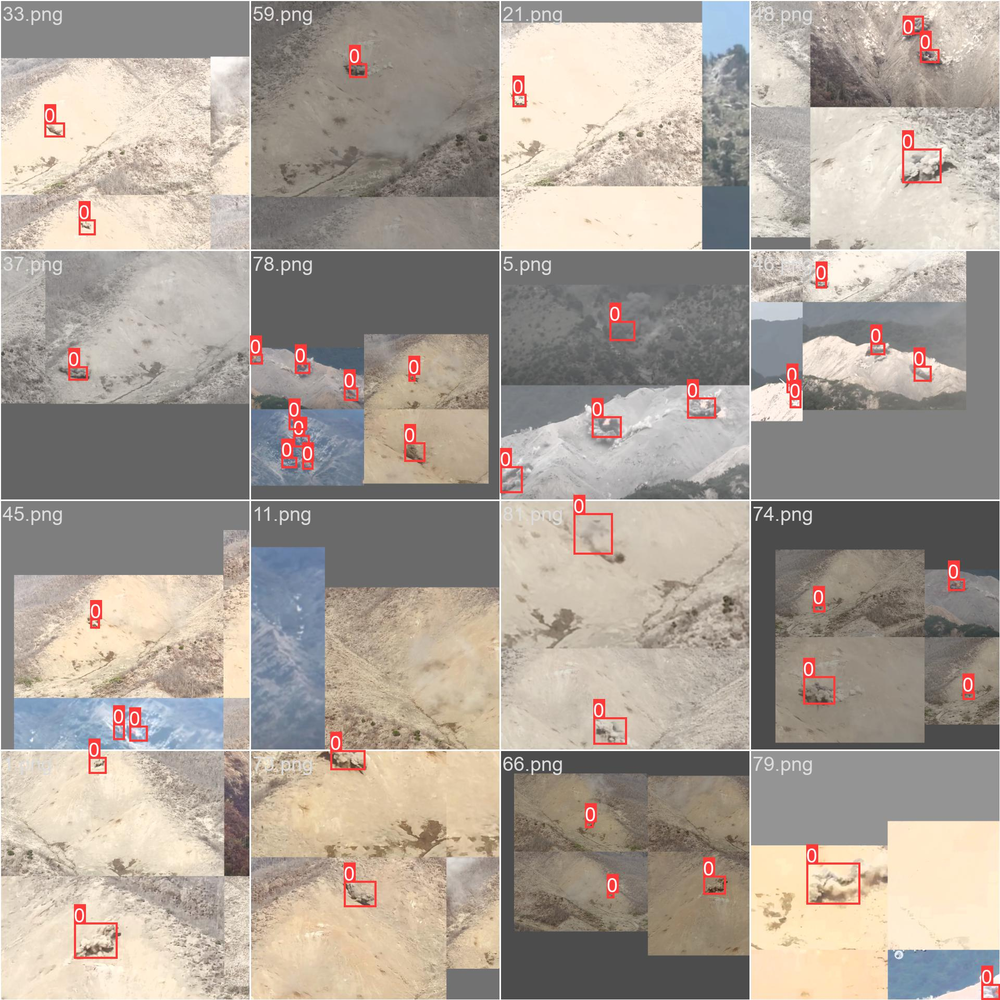

In [ ]:
Image(filename='runs/train/artillery_results/train_batch0.jpg', width=1000)

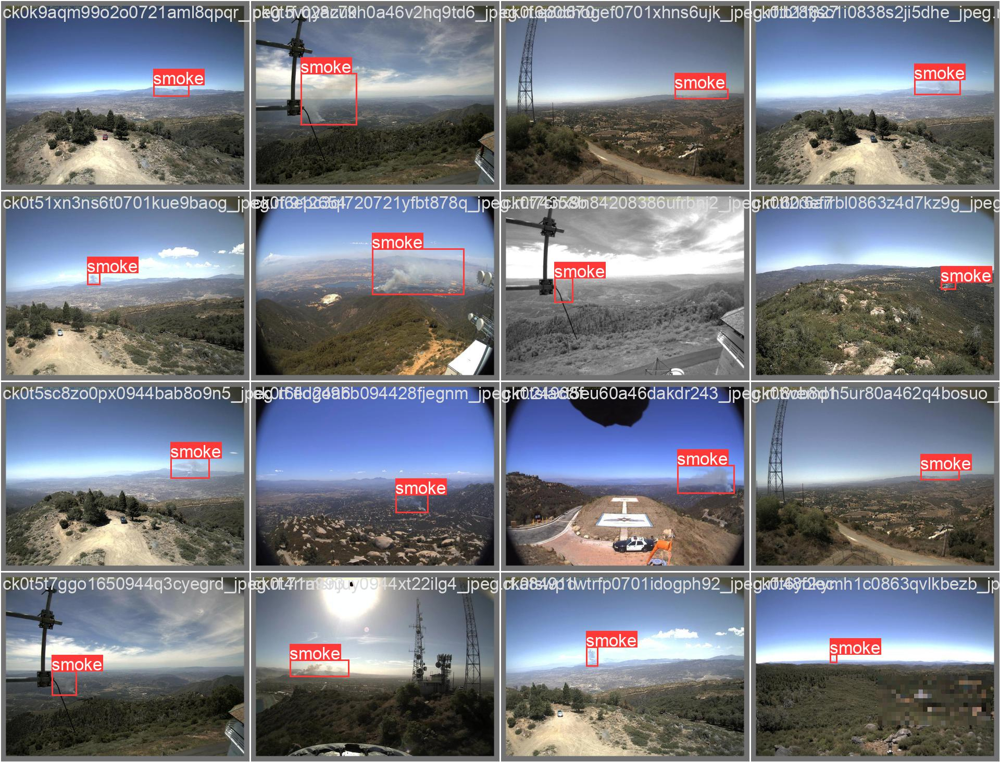

In [ ]:
Image(filename='runs/train/smoke_results4/val_batch0_labels.jpg', width=1000)

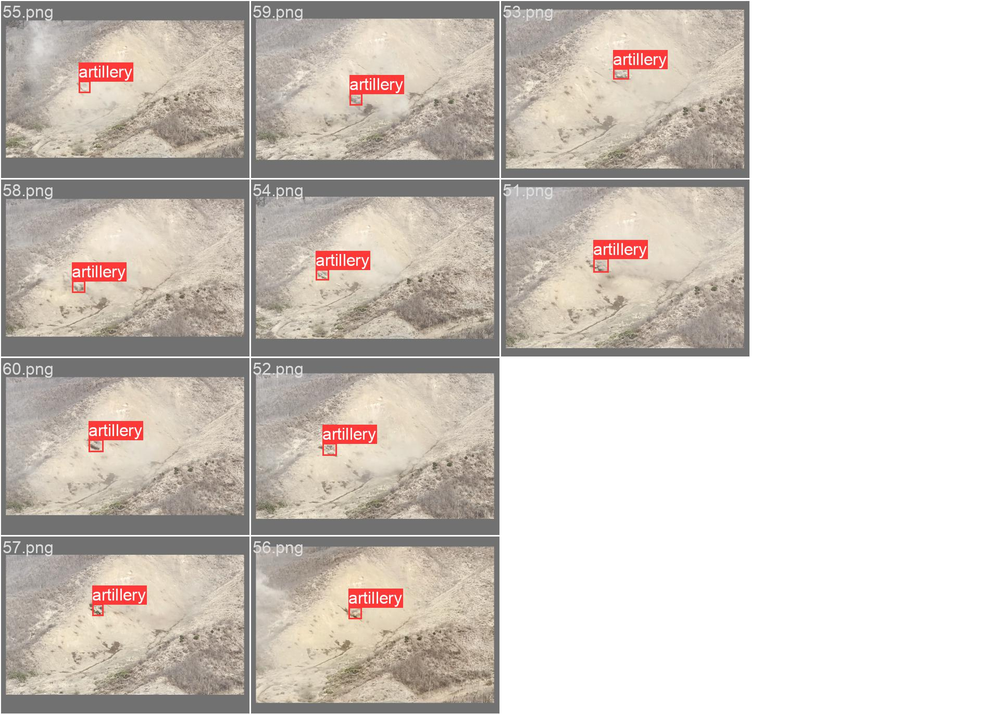

In [ ]:
Image(filename='runs/train/artillery_results2/val_batch0_labels.jpg', width=1000)

In [ ]:
!python val.py --weights runs/train/smoke_results4/weights/best.pt --data ./smoke/data.yaml --img 640 --iou 0.65 --half

python3: can't open file '/content/val.py': [Errno 2] No such file or directory


In [ ]:
!python val.py --weights runs/train/artillery_results/weights/best.pt --data ./artillery/data.yaml --img 640 --iou 0.65 --half

val: data=./artillery/data.yaml, weights=['runs/train/artillery_results/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.65, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=True, dnn=False
YOLOv5 🚀 v7.0-128-gb96f35c Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
val: Scanning /content/yolov5/artillery/valid/labels.cache... 10 images, 0 backgrounds, 0 corrupt: 100% 10/10 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 1/1 [00:01<00:00,  1.97s/it]
                   all         10         10          0          0          0          0
Speed: 0.2ms pre-process, 20.4ms inference, 94.0ms NMS per image at shape (32, 3, 640, 640)
Resu

In [ ]:
!python val.py --weights runs/train/artillery_results2/weights/best.pt --data ./artillery/data.yaml --img 640 --iou 0.65 --half

val: data=./artillery/data.yaml, weights=['runs/train/artillery_results2/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.65, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=True, dnn=False
YOLOv5 🚀 v7.0-128-gb96f35c Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
val: Scanning /content/yolov5/artillery/valid/labels.cache... 30 images, 0 backgrounds, 0 corrupt: 100% 30/30 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 1/1 [00:02<00:00,  2.90s/it]
                   all         30         30   0.000333        0.1   0.000257    4.1e-05
Speed: 0.2ms pre-process, 6.1ms inference, 5.1ms NMS per image at shape (32, 3, 640, 640)
Resul

In [ ]:
!python val.py --weights runs/train/artillery_results3/weights/best.pt --data ./artillery/data.yaml --img 640 --iou 0.65 --half

val: data=./artillery/data.yaml, weights=['runs/train/artillery_results3/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.65, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=True, dnn=False
YOLOv5 🚀 v7.0-116-g5c91dae Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
val: Scanning /content/yolov5/artillery/valid/labels.cache... 11 images, 0 backgrounds, 0 corrupt: 100% 11/11 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 1/1 [00:00<00:00,  1.20it/s]
                   all         11         24    0.00303      0.417     0.0126     0.0022
Speed: 0.3ms pre-process, 18.0ms inference, 30.3ms NMS per image at shape (32, 3, 640, 640)
Res

In [ ]:
!python val.py --weights runs/train/smoke_results4/weights/best.pt --data ./smoke/data.yaml --img 640 --iou 0.65 --task test

val: data=./smoke/data.yaml, weights=['runs/train/smoke_results4/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.65, max_det=300, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-116-g5c91dae Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
test: Scanning /content/yolov5/smoke/test/labels... 74 images, 0 backgrounds, 0 corrupt: 100% 74/74 [00:00<00:00, 365.05it/s]
test: New cache created: /content/yolov5/smoke/test/labels.cache
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 3/3 [00:02<00:00,  1.18it/s]
                   all         74         74      0.956      0.883      0.966       0.52
Speed: 0.2ms pre-process, 8.2ms infer

In [ ]:
!python val.py --weights runs/train/artillery_results5/weights/best.pt --data ./artillery/data.yaml --img 640 --iou 0.65 --task test

val: data=./artillery/data.yaml, weights=['runs/train/artillery_results5/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.65, max_det=300, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-116-g5c91dae Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
test: Scanning /content/yolov5/artillery/test/labels.cache... 7 images, 0 backgrounds, 0 corrupt: 100% 7/7 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 1/1 [00:00<00:00,  1.44it/s]
                   all          7         16    0.00333      0.438     0.0024   0.000752
Speed: 0.3ms pre-process, 8.4ms inference, 50.8ms NMS per image at shape (32, 3, 640, 640)
Resul

In [ ]:
!python detect.py --weights runs/train/smoke_results4/weights/best.pt --img 640 --conf 0.4 --source ./smoke/test/images

detect: weights=['runs/train/smoke_results4/weights/best.pt'], source=./smoke/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-116-g5c91dae Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/74 /content/yolov5/smoke/test/images/ck0kcoc8ik6ni0848clxs0vif_jpeg.rf.8b4629777ffe1d349cc970ee8af59eac.jpg: 480x640 1 smoke, 11.6ms
image 2/74 /content/yolov5/smoke/test/images/ck0kd4afx8g470701watkwxut_jpeg.rf.bb5a1f2c2b04be20c948fd3c5cec33ff.jpg: 480x640 1 smoke, 10.0ms
image 3/74 /content/yolov5/smoke/test/images/

In [ ]:
!python detect.py --weights runs/train/artillery_results2/weights/best.pt --img 640 --conf 0.1 --source ./artillery/train/images

detect: weights=['runs/train/artillery_results2/weights/best.pt'], source=./artillery/train/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-128-gb96f35c Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/74 /content/yolov5/artillery/train/images/1.png: 448x640 5 artillerys, 13.4ms
image 2/74 /content/yolov5/artillery/train/images/10.png: 640x640 9 artillerys, 12.7ms
image 3/74 /content/yolov5/artillery/train/images/11.png: 576x640 5 artillerys, 13.1ms
image 4/74 /content/yolov5/artillery/train/images/12.png: 

In [ ]:
!python detect.py --weights runs/train/artillery_results2/weights/best.pt --img 640 --conf 0.2 --source ./artillery/train/images

detect: weights=['runs/train/artillery_results2/weights/best.pt'], source=./artillery/train/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.2, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-128-gb96f35c Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/74 /content/yolov5/artillery/train/images/1.png: 448x640 2 artillerys, 12.5ms
image 2/74 /content/yolov5/artillery/train/images/10.png: 640x640 5 artillerys, 12.7ms
image 3/74 /content/yolov5/artillery/train/images/11.png: 576x640 4 artillerys, 13.0ms
image 4/74 /content/yolov5/artillery/train/images/12.png: 

In [ ]:
!python detect.py --weights runs/train/artillery_results3/weights/best.pt --img 640 --conf 0.02 --source ./artillery/train/images

detect: weights=['runs/train/artillery_results3/weights/best.pt'], source=./artillery/train/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.02, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-116-g5c91dae Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/21 /content/yolov5/artillery/train/images/1.png: 448x640 (no detections), 12.1ms
image 2/21 /content/yolov5/artillery/train/images/10.png: 640x640 (no detections), 12.7ms
image 3/21 /content/yolov5/artillery/train/images/11.png: 576x640 (no detections), 12.4ms
image 4/21 /content/yolov5/artillery/train/image

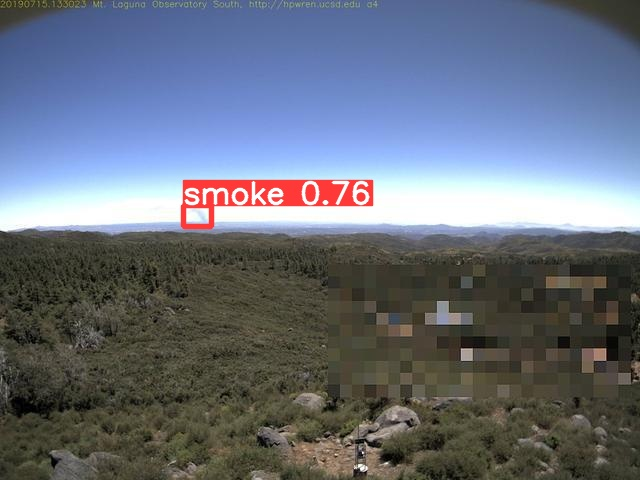

In [ ]:
import glob
import random
image_name = random.choice(glob.glob('runs/detect/exp3/*.jpg'))
display(Image(filename=image_name))

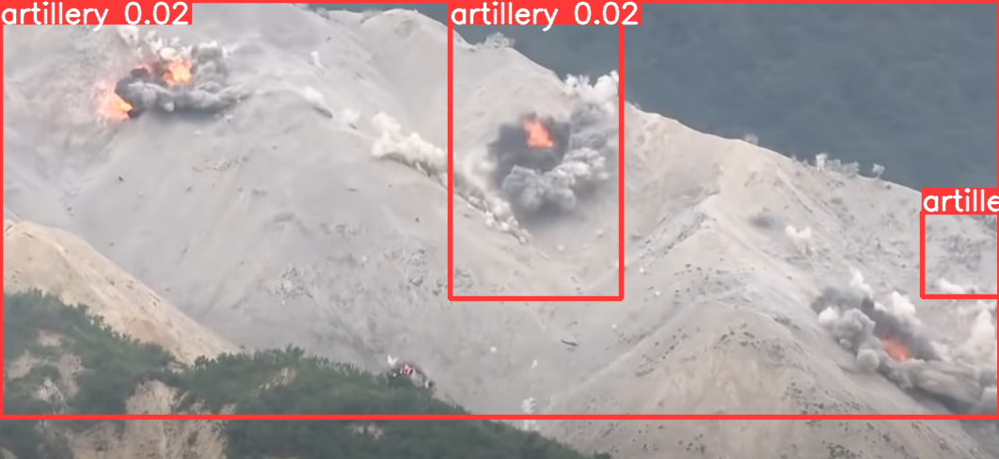

In [ ]:
import glob
import random
image_name = random.choice(glob.glob('runs/detect/exp23/*.png'))
display(Image(filename=image_name))

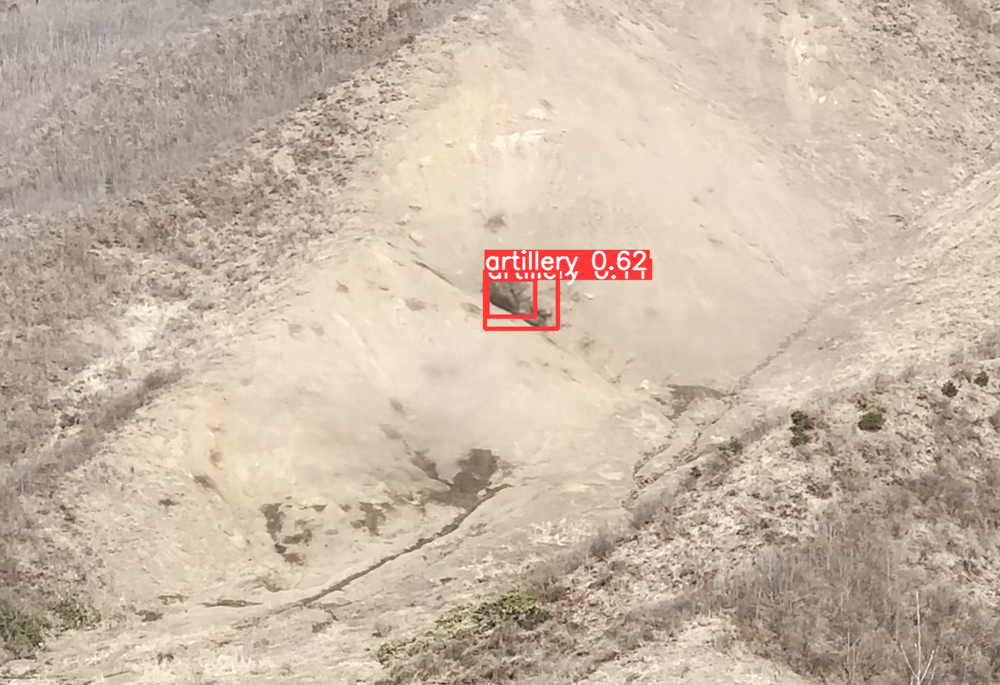

In [ ]:
import glob
import random
image_name = random.choice(glob.glob('runs/detect/exp4/*.png'))
display(Image(filename=image_name))

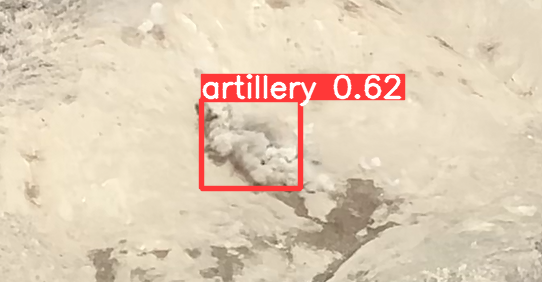

In [ ]:
import glob
import random
image_name = random.choice(glob.glob('runs/detect/exp4/*.png'))
display(Image(filename=image_name))

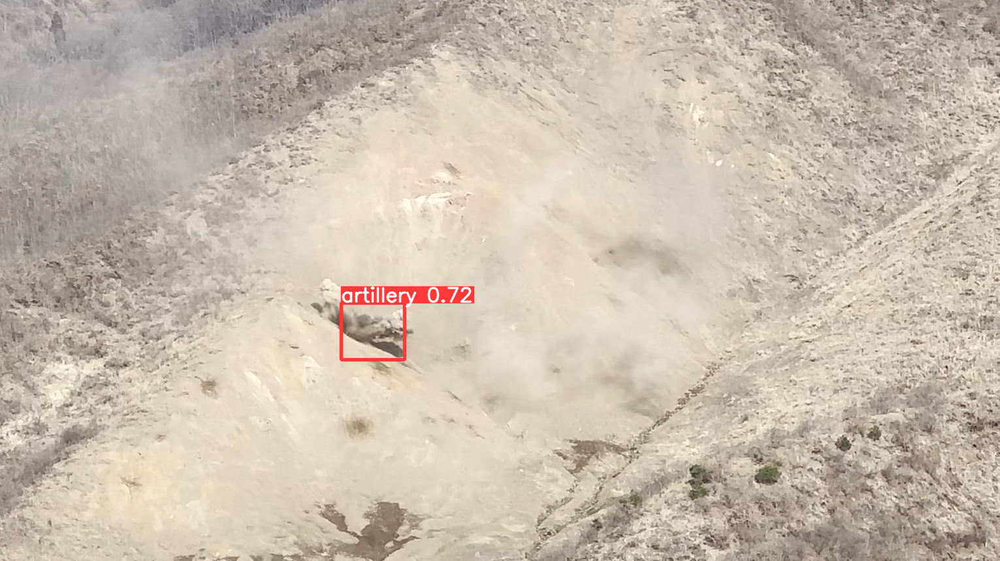

In [ ]:
import glob
import random
image_name = random.choice(glob.glob('runs/detect/exp4/*.png'))
display(Image(filename=image_name))

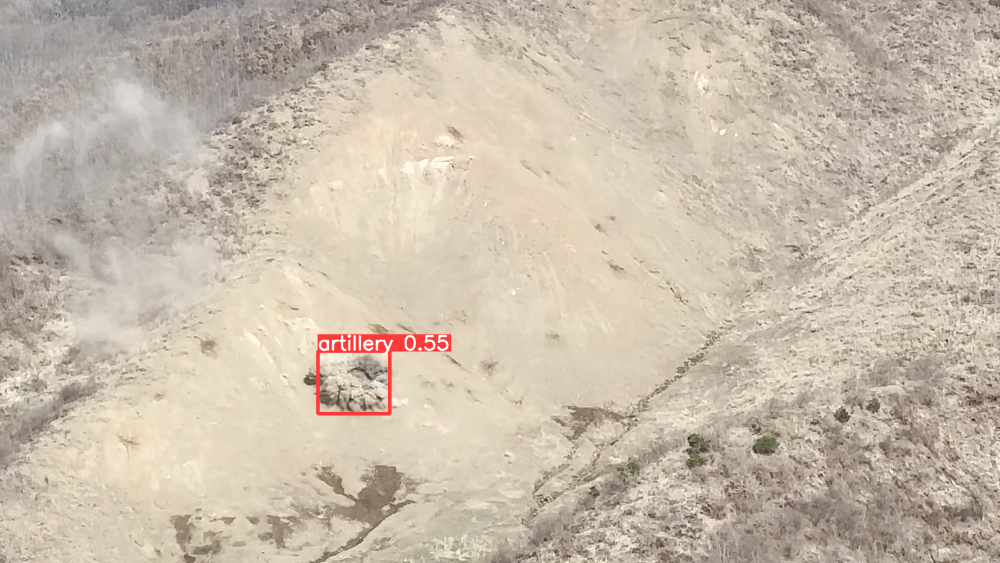

In [ ]:
import glob
import random
image_name = random.choice(glob.glob('runs/detect/exp4/*.png'))
display(Image(filename=image_name))

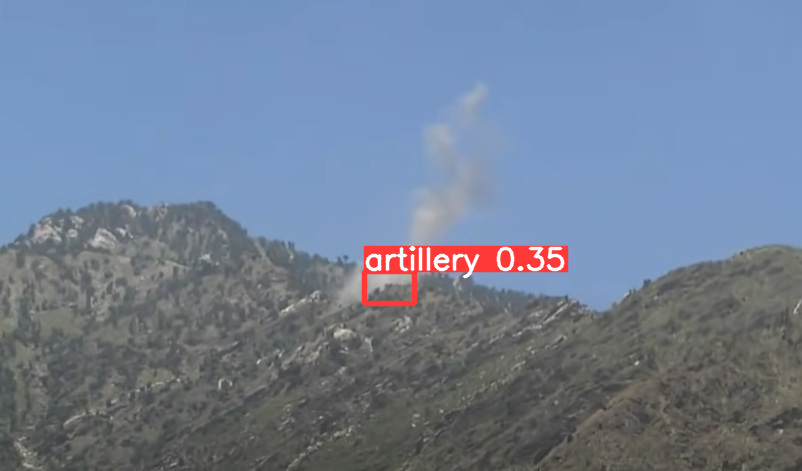

In [ ]:
import glob
import random
image_name = random.choice(glob.glob('runs/detect/exp5/*.png'))
display(Image(filename=image_name))

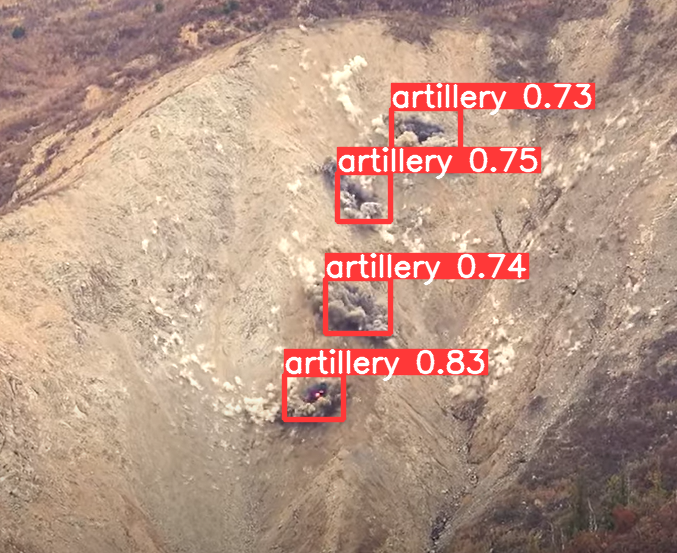

In [ ]:
image_name = random.choice(glob.glob('runs/detect/exp5/2.png'))
display(Image(filename=image_name))

In [ ]:
%mkdir /content/drive/My\ Drive/artillery/
%cp runs/train/artillery_results3/weights/best.pt /content/drive/My\ Drive/artillery/

mkdir: cannot create directory ‘/content/drive/My Drive/smoke/’: No such file or directory
cp: cannot stat 'runs/train/smoke_results/weights/best.pt': No such file or directory


In [ ]:
!python detect.py --weights runs/train/artillery_results2/weights/best.pt --img 640 --conf 0.1 --source ./artillery/train/images

detect: weights=['runs/train/artillery_results2/weights/best.pt'], source=./artillery/train/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-116-g5c91dae Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
image 1/21 /content/yolov5/artillery/train/images/1.png: 448x640 (no detections), 13.1ms
image 2/21 /content/yolov5/artillery/train/images/10.png: 640x640 (no detections), 12.6ms
image 3/21 /content/yolov5/artillery/train/images/11.png: 576x640 (no detections), 12.5ms
image 4/21 /content/yolov5/artillery/train/images